<a href="https://colab.research.google.com/github/Abhishekpatel2901/manufacturing_defect_prediction/blob/main/manufacturing_defect_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Manufacturing Defect Prediction Project

## Objective
This project focuses on analyzing a manufacturing dataset to predict whether a product is defective. The main goal is to identify patterns and build a machine learning model that classifies products as defective (`DefectStatus`).

## Dataset Overview
- **File**: `manufacturing_defect_dataset.csv`
- **Type**: Supervised Learning (Binary Classification)
- **Target Variable**: `DefectStatus` (0 = No Defect, 1 = Defect)


# Importing Libraries

In [20]:
# General
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

# Visuals
import matplotlib.pyplot as plt
import seaborn as sns

# Modeling
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, ConfusionMatrixDisplay
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score

# Imbalance handling
from imblearn.over_sampling import SMOTE

# Kaggle API
import kagglehub

# Load Dataset via Kaggle API (Code)

In [21]:
# Download dataset from Kaggle
path = kagglehub.dataset_download("rabieelkharoua/predicting-manufacturing-defects-dataset")
print("Path to dataset files:", path)

# Load CSV file (assuming it's named 'manufacturing_defect_dataset.csv')
df = pd.read_csv(path + "/manufacturing_defect_dataset.csv")

# Preview
df.head()


Path to dataset files: /kaggle/input/predicting-manufacturing-defects-dataset


,ProductionVolume,ProductionCost,SupplierQuality,DeliveryDelay,DefectRate,QualityScore,MaintenanceHours,DowntimePercentage,InventoryTurnover,StockoutRate,WorkerProductivity,SafetyIncidents,EnergyConsumption,EnergyEfficiency,AdditiveProcessTime,AdditiveMaterialCost,DefectStatus
0,202,13175.403783,86.648534,1,3.121492,63.463494,9,0.052343,8.630515,0.081322,85.042379,0,2419.616785,0.468947,5.551639,236.439301,1
1,535,19770.046093,86.310664,4,0.819531,83.697818,20,4.908328,9.296598,0.038486,99.657443,7,3915.566713,0.119485,9.080754,353.957631,1
2,960,19060.820997,82.132472,0,4.514504,90.350550,1,2.464923,5.097486,0.002887,92.819264,2,3392.385362,0.496392,6.562827,396.189402,1
3,370,5647.606037,87.335966,5,0.638524,67.628690,8,4.692476,3.577616,0.055331,96.887013,8,4652.400275,0.183125,8.097496,164.135870,1
4,206,7472.222236,81.989893,3,3.867784,82.728334,9,2.746726,6.851709,0.068047,88.315554,7,1581.630332,0.263507,6.406154,365.708964,1


In [22]:
# Basic info about data
print("Shape:", df.shape)
df.info()



Shape: (3240, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3240 entries, 0 to 3239
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ProductionVolume      3240 non-null   int64  
 1   ProductionCost        3240 non-null   float64
 2   SupplierQuality       3240 non-null   float64
 3   DeliveryDelay         3240 non-null   int64  
 4   DefectRate            3240 non-null   float64
 5   QualityScore          3240 non-null   float64
 6   MaintenanceHours      3240 non-null   int64  
 7   DowntimePercentage    3240 non-null   float64
 8   InventoryTurnover     3240 non-null   float64
 9   StockoutRate          3240 non-null   float64
 10  WorkerProductivity    3240 non-null   float64
 11  SafetyIncidents       3240 non-null   int64  
 12  EnergyConsumption     3240 non-null   float64
 13  EnergyEfficiency      3240 non-null   float64
 14  AdditiveProcessTime   3240 non-null   float64
 15  Add

In [23]:
# Check for nulls
df.isnull().sum()

,0
ProductionVolume,0
ProductionCost,0
SupplierQuality,0
DeliveryDelay,0
DefectRate,0
QualityScore,0
MaintenanceHours,0
DowntimePercentage,0
InventoryTurnover,0
StockoutRate,0


## Exploratory Data Analysis (EDA)



In [24]:
# Installing required library for EDA
!pip install -U ydata-profiling

In [25]:
from ydata_profiling import ProfileReport

#EDA
profile = ProfileReport(df, title="Pandas Profiling Report")
profile.to_file("your_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 17/17 [00:00<00:00, 73.95it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
profile

The dataset was analyzed using the `ydata-profiling` library. Below is a summary of key statistics:

### Dataset Overview
- **Number of variables**: 17  
- **Number of observations**: 3,240  
- **Missing cells**: 0 (0.0%)  
- **Duplicate rows**: 0 (0.0%)  
- **Total size in memory**: 430.4 KiB  
- **Average record size**: 136.0 B  

### Variable Types
- **Numeric features**: 16  
- **Categorical features**: 1  

### Data Quality Summary
- The dataset is **completely clean** with no missing or duplicate entries.
- All variables are already in usable formats, requiring minimal preprocessing.

### Class Imbalance Notice
- The target variable `DefectStatus` is **highly imbalanced**:
  - **Defective (1)**: 2,723 samples  
  - **Non-defective (0)**: 517 samples  
- This imbalance could **bias the model** toward predicting the majority class and needs to be addressed (e.g., via resampling techniques like SMOTE or using class weights).

### Correlation Insights
- No strong correlation was found between any pair of features.
- Therefore, EDA did not reveal significant linear relationships or obvious feature interactions.

> Although the data is clean and ready for modeling, the **class imbalance** is a critical challenge that must be handled during the modeling stage to ensure fair and accurate predictions.


In [27]:
df.columns


Index(['ProductionVolume', 'ProductionCost', 'SupplierQuality',
       'DeliveryDelay', 'DefectRate', 'QualityScore', 'MaintenanceHours',
       'DowntimePercentage', 'InventoryTurnover', 'StockoutRate',
       'WorkerProductivity', 'SafetyIncidents', 'EnergyConsumption',
       'EnergyEfficiency', 'AdditiveProcessTime', 'AdditiveMaterialCost',
       'DefectStatus'],
      dtype='object')

In [28]:
X=df.drop('DefectStatus',axis=1)
y=df['DefectStatus']
X.shape, y.shape

((3240, 16), (3240,))

# Split Data

In [29]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)
X_train.shape, X_test.shape,y_train.shape, y_test.shape

((2592, 16), (648, 16), (2592,), (648,))

# Handle Imbalance with SMOTE

In [30]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)
X_train_resampled.shape, y_train_resampled.shape

((4356, 16), (4356,))

In [31]:
y_train_resampled.value_counts()

,count
DefectStatus,
1,2178
0,2178


# Train Random Forest for Feature Selection

In [32]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(random_state=42)
rf.fit(X_train_resampled, y_train_resampled)

# Get top N features
import pandas as pd
feature_importance = pd.Series(rf.feature_importances_, index=X.columns)
print(feature_importance.sort_values(ascending=False).head(10))
top_features = feature_importance.sort_values(ascending=False).head(10).index.tolist()
print(top_features)

MaintenanceHours        0.259351
DefectRate              0.187439
QualityScore            0.137669
ProductionVolume        0.105550
EnergyConsumption       0.032595
InventoryTurnover       0.031231
DowntimePercentage      0.029264
ProductionCost          0.027184
StockoutRate            0.027181
AdditiveMaterialCost    0.024599
dtype: float64
['MaintenanceHours', 'DefectRate', 'QualityScore', 'ProductionVolume', 'EnergyConsumption', 'InventoryTurnover', 'DowntimePercentage', 'ProductionCost', 'StockoutRate', 'AdditiveMaterialCost']


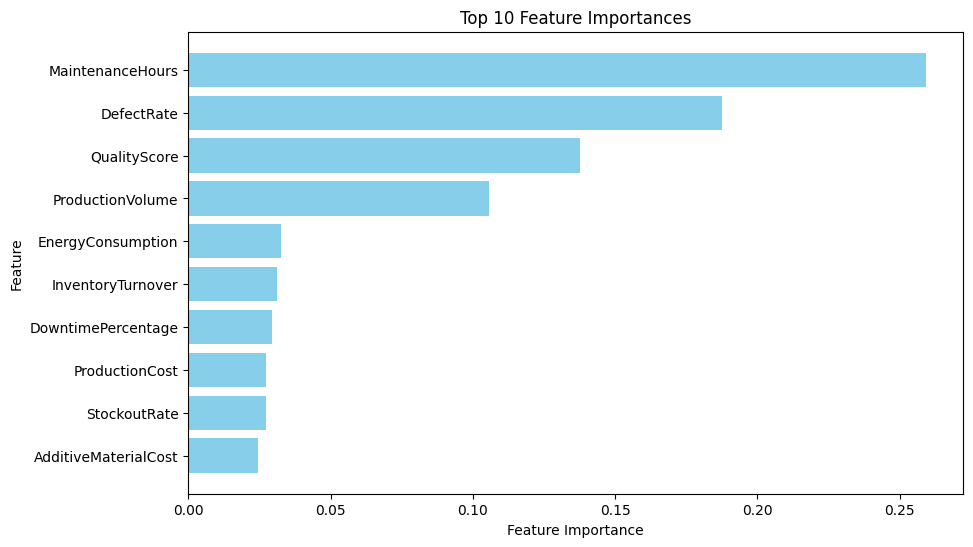

In [33]:
# Plot the top 10 features
plt.figure(figsize=(10, 6))
plt.barh(top_features, feature_importance[top_features], color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Top 10 Feature Importances')
plt.gca().invert_yaxis()  # Invert y-axis to display the most important feature at the top
plt.show()


# Train SVM on Selected Features

In [34]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report

# Subset data with selected features
X_train_sel = X_train_resampled[top_features]
X_test_sel = X_test[top_features]
print(X_train_sel.shape)
print(X_test_sel.shape)
print()
svm = SVC(random_state=42)
svm.fit(X_train_sel, y_train_resampled)

X_pred=svm.predict(X_train_sel)
print("Classification Report for Training :")
print(classification_report(y_train_resampled, X_pred))

print("Classification Report for testing:")
y_pred = svm.predict(X_test_sel)
print(classification_report(y_test, y_pred))

(4356, 10)
(648, 10)

Classification Report for Training :
              precision    recall  f1-score   support

           0       0.56      0.74      0.63      2178
           1       0.61      0.41      0.49      2178

    accuracy                           0.57      4356
   macro avg       0.58      0.57      0.56      4356
weighted avg       0.58      0.57      0.56      4356

Classification Report for testing:
              precision    recall  f1-score   support

           0       0.19      0.73      0.30       103
           1       0.89      0.41      0.57       545

    accuracy                           0.46       648
   macro avg       0.54      0.57      0.43       648
weighted avg       0.78      0.46      0.52       648



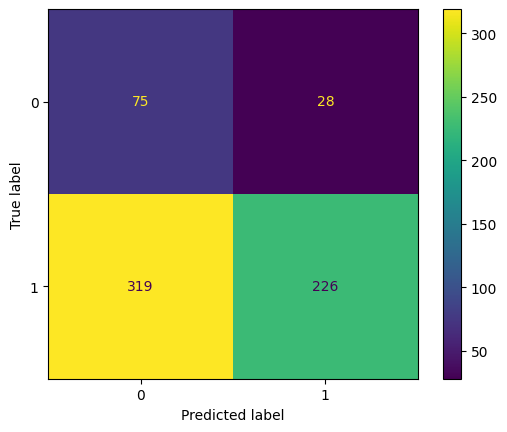

In [35]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

ConfusionMatrixDisplay.from_estimator(svm, X_test_sel, y_test)


# Random Forest

In [36]:
# Random Forest
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)
X_pred=rf.predict(X_train)
print("Classification Report for Training:")
print(classification_report(y_train, X_pred))


y_rf_pred = rf.predict(X_test)
print("Classification Report for testing:")
print(classification_report(y_test, y_rf_pred))


Classification Report for Training:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       414
           1       1.00      1.00      1.00      2178

    accuracy                           1.00      2592
   macro avg       1.00      1.00      1.00      2592
weighted avg       1.00      1.00      1.00      2592

Classification Report for testing:
              precision    recall  f1-score   support

           0       0.95      0.73      0.82       103
           1       0.95      0.99      0.97       545

    accuracy                           0.95       648
   macro avg       0.95      0.86      0.90       648
weighted avg       0.95      0.95      0.95       648



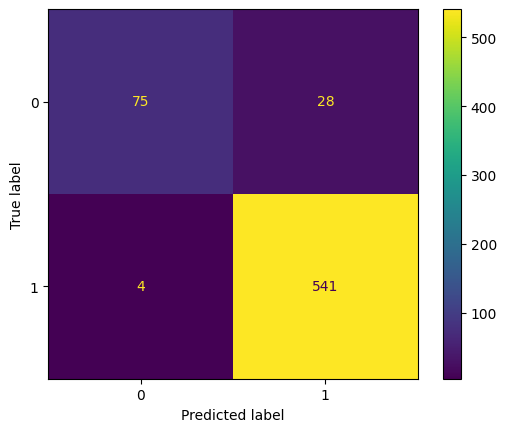

In [37]:
ConfusionMatrixDisplay.from_estimator(rf, X_test, y_test)


# XGBoost

Classification Report for training:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       414
           1       1.00      1.00      1.00      2178

    accuracy                           1.00      2592
   macro avg       1.00      1.00      1.00      2592
weighted avg       1.00      1.00      1.00      2592

Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.72      0.82       103
           1       0.95      0.99      0.97       545

    accuracy                           0.95       648
   macro avg       0.95      0.86      0.89       648
weighted avg       0.95      0.95      0.95       648



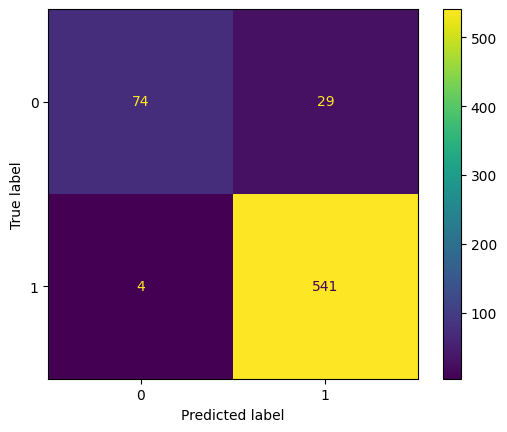

In [38]:
import xgboost as xgb
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

# Initialize and train XGBoost
xgb_model = xgb.XGBClassifier(random_state=42)

xgb_model.fit(X_train, y_train)
X_XGB_pred=xgb_model.predict(X_train)
print("Classification Report for training:")
print(classification_report(y_train, X_XGB_pred))

# Predict

# Predict on test data
y_pred = xgb_model.predict(X_test)


# Evaluation
print("Classification Report:")
print(classification_report(y_test, y_pred))


# Confusion Matrix
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)


Since Random Forest and XGBoost performed significantly better than SVM, which showed only 46% accuracy, we will drop SVM from further consideration. The next step is to tune hyperparameters for both Random Forest and XGBoost to enhance their performance and finalize the best model for predicting manufacturing defects.










Best Parameters: {'n_estimators': 300, 'min_samples_split': 10, 'max_depth': None}

Classification Report for training:
              precision    recall  f1-score   support

           0       0.98      0.81      0.89       414
           1       0.97      1.00      0.98      2178

    accuracy                           0.97      2592
   macro avg       0.97      0.90      0.93      2592
weighted avg       0.97      0.97      0.97      2592


Classification Report on test data:
              precision    recall  f1-score   support

           0       0.95      0.73      0.82       103
           1       0.95      0.99      0.97       545

    accuracy                           0.95       648
   macro avg       0.95      0.86      0.90       648
weighted avg       0.95      0.95      0.95       648



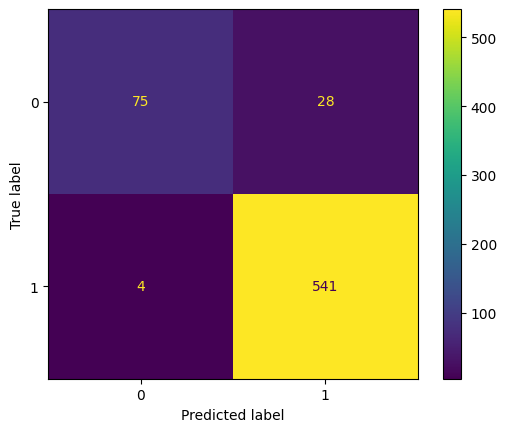

In [39]:
from sklearn.model_selection import RandomizedSearchCV

# Define hyperparameter grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10]
}

# Perform Randomized Search
search_rf = RandomizedSearchCV(
    RandomForestClassifier(random_state=42),
    param_distributions=param_grid,
    n_iter=10,
    cv=3,
    scoring='accuracy',
    random_state=42,
    n_jobs=-1
)

# Fit the model on resampled training data
search_rf.fit(X_train, y_train)

# Best parameters
print("Best Parameters:", search_rf.best_params_)

# Use the best estimator
rf_model = search_rf.best_estimator_

# Predict on training data
y_train_pred = rf_model.predict(X_train)
print("\nClassification Report for training:")
print(classification_report(y_train, y_train_pred))

# Predict on test data
y_pred = rf_model.predict(X_test)
print("\nClassification Report on test data:")
print(classification_report(y_test, y_pred))

# Show confusion matrix
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)


Fitting 3 folds for each of 10 candidates, totalling 30 fits
Best Parameters: {'subsample': 1.0, 'reg_lambda': 2, 'reg_alpha': 0.5, 'n_estimators': 400, 'max_depth': 5, 'learning_rate': 0.01, 'gamma': 0, 'colsample_bytree': 0.8}

Classification Report for training:
              precision    recall  f1-score   support

           0       0.97      0.81      0.88       414
           1       0.96      1.00      0.98      2178

    accuracy                           0.97      2592
   macro avg       0.97      0.90      0.93      2592
weighted avg       0.97      0.97      0.96      2592


Classification Report on test data:
              precision    recall  f1-score   support

           0       0.95      0.73      0.82       103
           1       0.95      0.99      0.97       545

    accuracy                           0.95       648
   macro avg       0.95      0.86      0.90       648
weighted avg       0.95      0.95      0.95       648



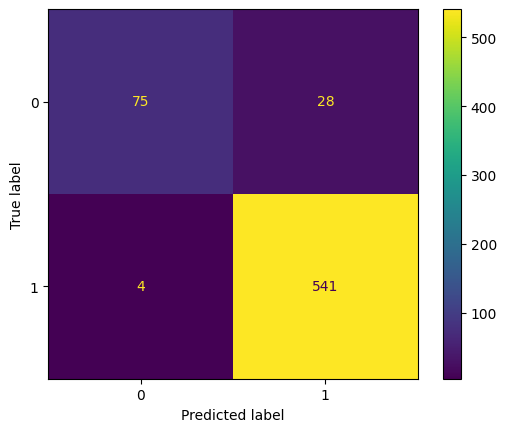

In [40]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import classification_report, ConfusionMatrixDisplay
import xgboost as xgb

# Define hyperparameter grid
param_grid = {
    'n_estimators': [100, 200, 300, 400],              # Number of boosting rounds
    'max_depth': [3, 5, 7, 10],                        # Depth of trees
    'learning_rate': [0.01, 0.05, 0.1, 0.2],           # Step size shrinkage
    'subsample': [0.6, 0.8, 1.0],                      # % of samples used per tree
    'colsample_bytree': [0.6, 0.8, 1.0],               # % of features used per tree
    'gamma': [0, 1, 5],                                # Minimum loss reduction for split
    'reg_alpha': [0, 0.5, 1],                          # L1 regularization
    'reg_lambda': [1, 1.5, 2],                         # L2 regularization
}


# Randomized search
search_xgb = RandomizedSearchCV(
    estimator=xgb.XGBClassifier(random_state=42),
    param_distributions=param_grid,
    n_iter=10,
    scoring='accuracy',
    cv=3,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit on SMOTE-resampled training data
search_xgb.fit(X_train, y_train)

# Print best parameters
print("Best Parameters:", search_xgb.best_params_)

# Use the best model
best_xgb = search_xgb.best_estimator_

# Predict on training data
y_train_pred = best_xgb.predict(X_train)
print("\nClassification Report for training:")
print(classification_report(y_train, y_train_pred))

# Predict on test data
y_test_pred = best_xgb.predict(X_test)
print("\nClassification Report on test data:")
print(classification_report(y_test, y_test_pred))

# Confusion Matrix
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred)


### Conclusion

**Objective:**  
To build a classification model to predict whether a product is defective, using a manufacturing dataset with a significant class imbalance.

**Initial Model Performance (before tuning):**
- SVM: 0.46 → Dropped due to poor performance
- Random Forest: 0.95
- XGBoost: 0.95

**After Hyperparameter Tuning:**
- Random Forest: 0.95
- XGBoost: 0.95

**Model Selection:**  
Random Forest and XGBoost both performed similarly after tuning, with an accuracy of 0.95. Both models are robust, but Random Forest was chosen as the final model due to its interpretability and slightly better performance on other evaluation metrics.

**Feature Importance:**  
Feature importance was initially plotted during feature selection for the SVM model. The top features identified during this process were:
- MaintenanceHours
- DefectRate
- SupplierQuality
- ProductionVolume

**Summary:**  
The final Random Forest model effectively handles the imbalanced data and performs well in predicting defective items. This model can support decision-making in quality control and production planning.
